In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 4.4 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15263, done.
remote: Counting objects: 100% (284/284), done.
remote: Compressing objects: 100% (181/181), done.
remote: Total 15263 (delta 148), reused 171 (delta 103), pack-reused 14979
Receiving objects: 100% (15263/15263), 6.29 MiB | 9.03 MiB/s, done.
Resolving deltas: 100% (11015/11015), done.


No CUDA runtime is found, using CUDA_HOME='/usr/local/cuda'


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 34.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 14.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any.whl size=61400 sha256=29c5865269f20dd1a88eb874fd987255b4f70d32e18de624dcff98102c3d8de2
  Stored in directory: /root/.cache/pip/wheels/01/c0/af/77c1cf53a1be9e42a52b48e5af2169d40ec2e89f7362489dd0
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144554 sha256=8196c7a6740ffdc8d476f60066b1f1f137d22486f555a838a589b013d727ca50
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a127e

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [ ]:
import detectron2
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

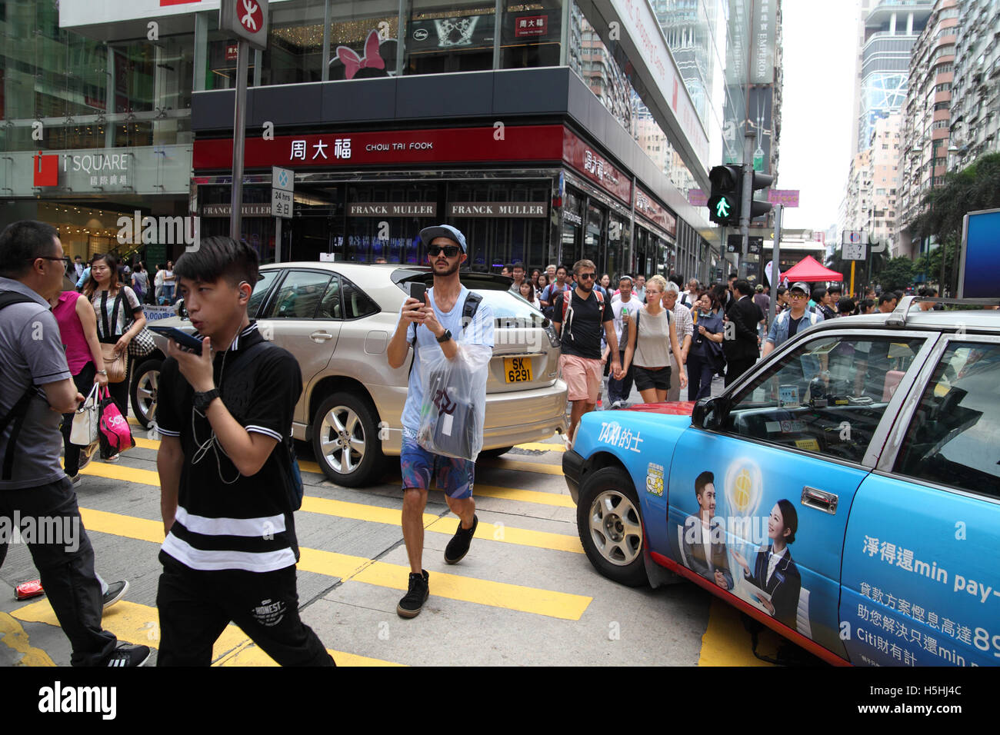

In [ ]:
my_new_image = cv2.imread("drive/MyDrive/colab/trial.jpg")
cv2_imshow(my_new_image)

model_final_a6e10b.pkl: 237MB [00:02, 115MB/s]                           
/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


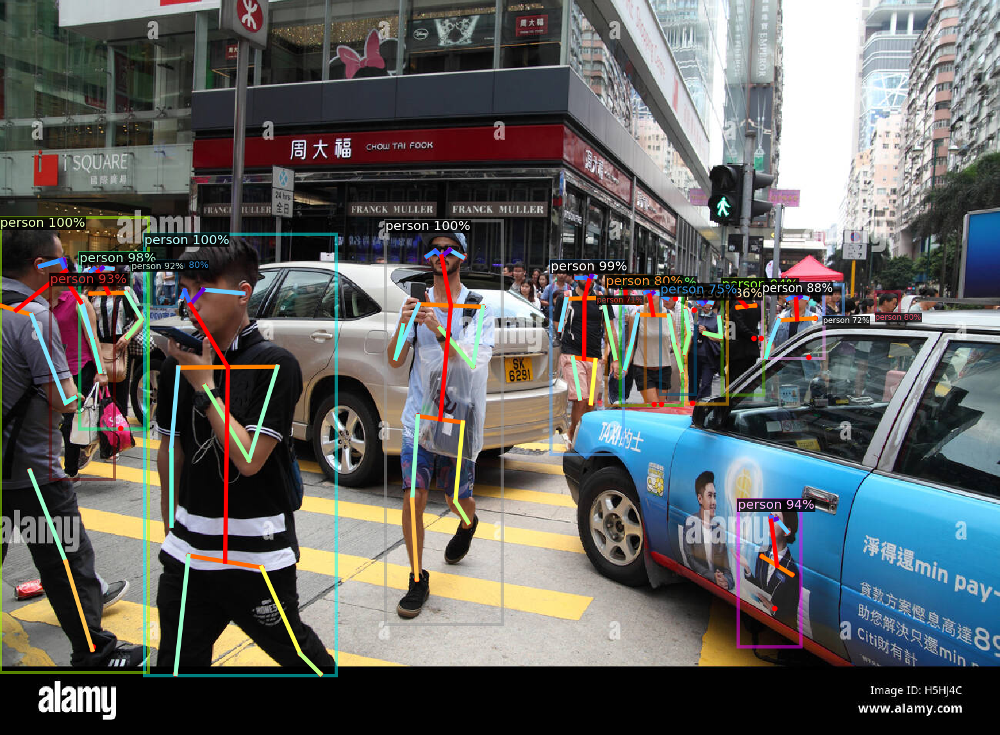

In [ ]:
cfg_keypoint = get_cfg()
cfg_keypoint.MODEL.DEVICE = 'cpu'
cfg_keypoint.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"))
cfg_keypoint.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
cfg_keypoint.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg_keypoint)
outputs = predictor(my_new_image)
v = Visualizer(my_new_image[:,:,::-1], MetadataCatalog.get(cfg_keypoint.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

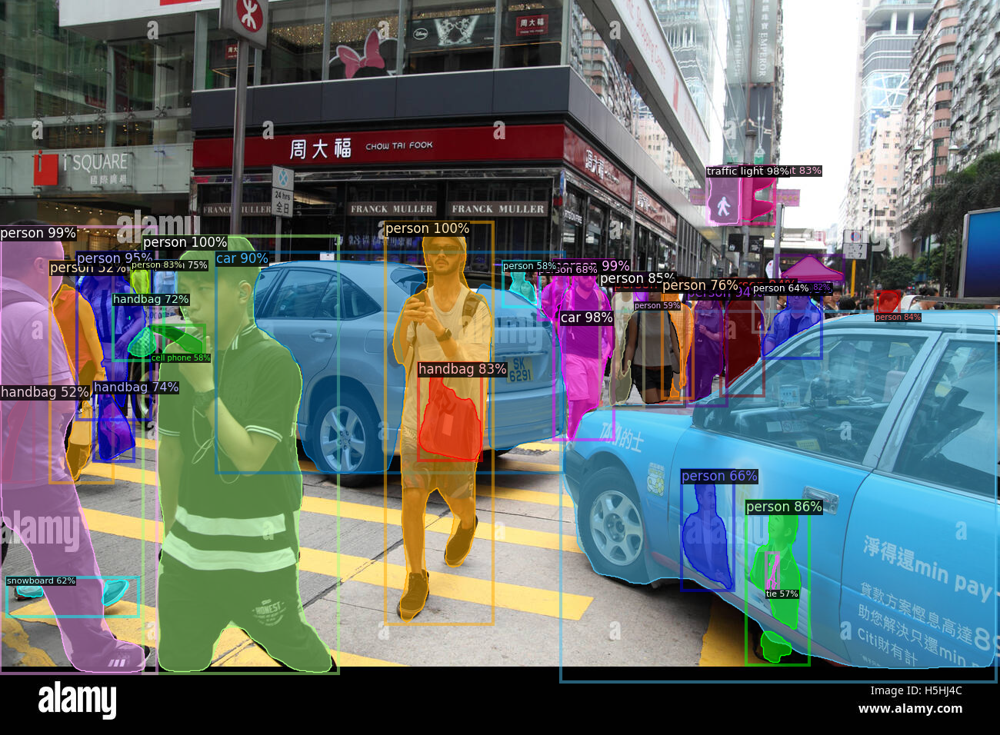

In [ ]:
cfg_inst = get_cfg()
cfg_inst.MODEL.DEVICE = 'cpu'
cfg_inst.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg_inst.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg_inst.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg_inst)
outputs = predictor(my_new_image)

v = Visualizer(my_new_image[:, :, ::-1], MetadataCatalog.get(cfg_inst.DATASETS.TRAIN[0]), scale=1.0)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

model_final_cafdb1.pkl: 261MB [00:02, 88.2MB/s]                          


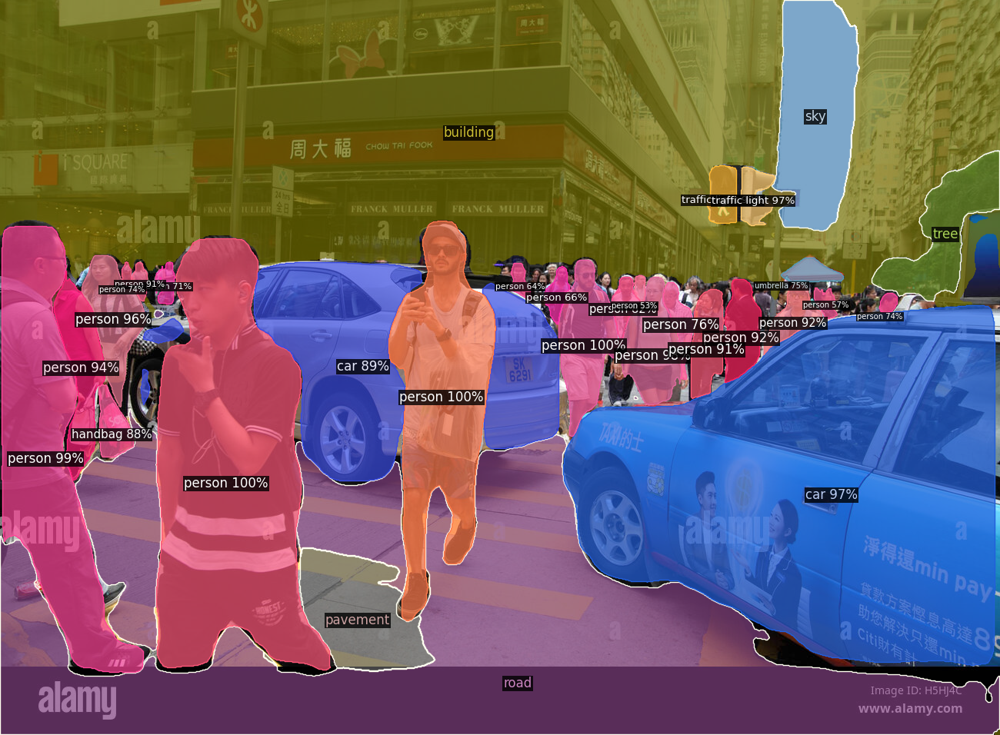

In [ ]:
cfg_pan = get_cfg()
cfg_pan.MODEL.DEVICE = 'cpu'
cfg_pan.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg_pan.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")
predictor = DefaultPredictor(cfg_pan)
panoptic_seg, segments_info = predictor(my_new_image)["panoptic_seg"]
v = Visualizer(my_new_image[:, :, ::-1], MetadataCatalog.get(cfg_pan.DATASETS.TRAIN[0]), scale=1.0)
out = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# from detectron2.data.datasets import register_coco_instances
# register_coco_instances("my_dataset_train1", {}, "labels/train.json", "images/train")
# register_coco_instances("my_dataset_val1", {}, "labels/val.json", "images/val")


from detectron2.structures import BoxMode

def get_images_dicts(img_dir):
    json_file = os.path.join(img_dir, "via_region_data.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}

        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]

        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["regions"]
        objs = []
        for _, anno in annos.items():
            anno = anno["shape_attributes"]
            px = anno["all_points_x"]
            py = anno["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

for d in ["train", "val"]:
    DatasetCatalog.register("images2_" + d, lambda d=d: get_images_dicts("drive/MyDrive/colab/images/" + d))
    MetadataCatalog.get("images2_" + d).set(thing_classes=["images"])
balloon_metadata = MetadataCatalog.get("images2_train")
# balloon_metadata = MetadataCatalog.get("images2_val")

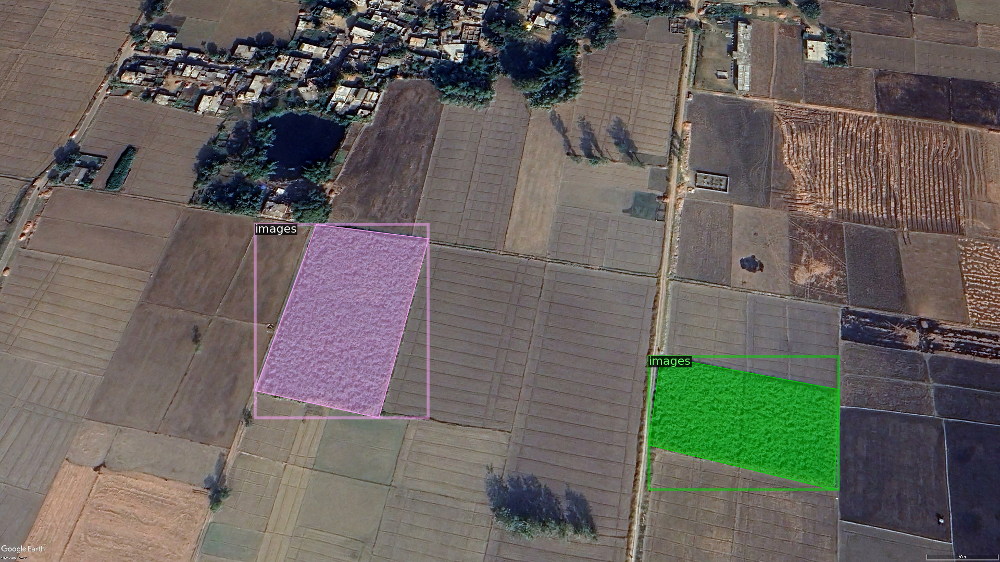

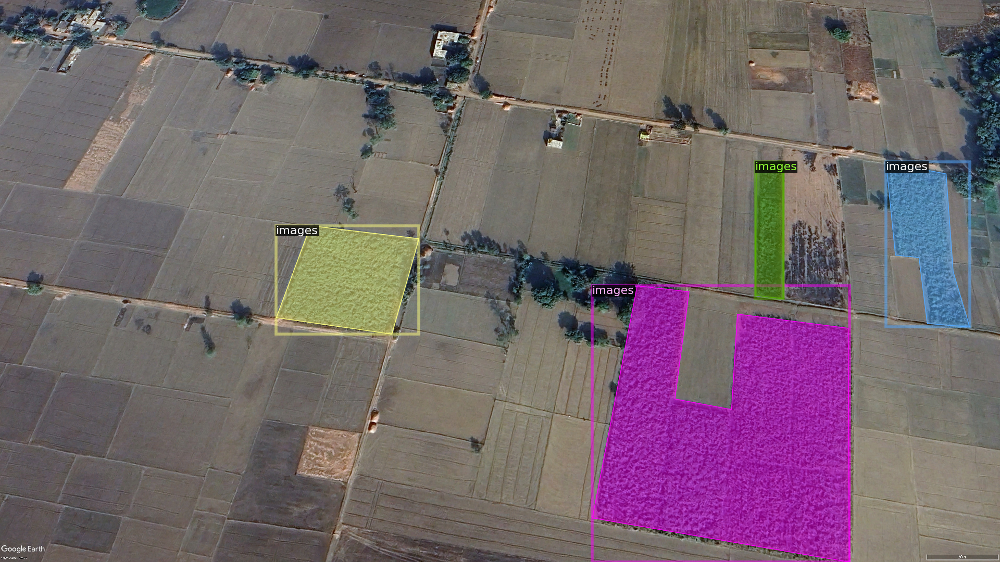

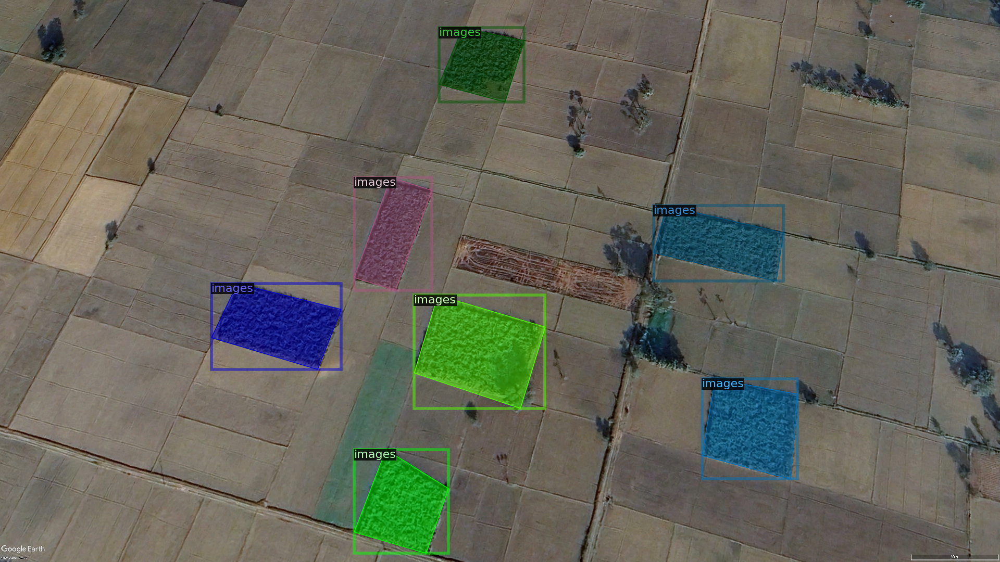

In [ ]:
dataset_dicts = get_images_dicts("drive/MyDrive/colab/images/train")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=balloon_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.MODEL.DEVICE = 'cpu'
cfg.OUTPUT_DIR = "drive/MyDrive/colab"
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("images2_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 100    # 100 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (sugarcane)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
# trainer.train()

[10/10 05:43:19 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [ ]:
import yaml
# Save the configuration to a config.yaml file
config_yaml_path = "drive/MyDrive/colab/config.yaml"
with open(config_yaml_path, 'w') as file:
    yaml.dump(cfg, file)

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[10/10 05:43:38 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from drive/MyDrive/colab/model_final.pth ...


     Unnamed: 0  Crop_Year       Season        State      Area  Production  \
0            21       1997  Kharif             Assam   31318.0     1287451   
1            54       1997  Whole Year     Karnataka  308857.0    28999269   
2            82       1997  Whole Year     Meghalaya      82.0         225   
3           124       1997  Whole Year   West Bengal   25797.0     1818700   
4           144       1998  Kharif        Puducherry    2710.0      232369   
..          ...        ...          ...          ...       ...         ...   
600       19561       2014  Winter            Odisha   10047.0      722892   
601       19589       2015  Winter            Odisha    8962.0      577158   
602       19618       2016  Winter            Odisha    5493.0      344294   
603       19647       2017  Winter            Odisha    3713.0      240245   
604       19676       2018  Winter            Odisha    6778.0      417672   

     Annual_Rainfall   Fertilizer  Pesticide      Yield  
0    

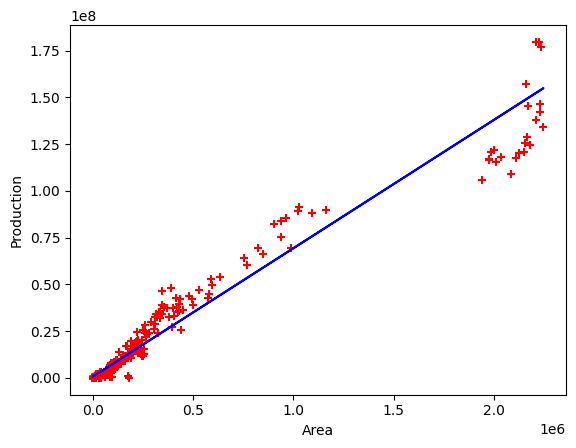

0.9564374411319788


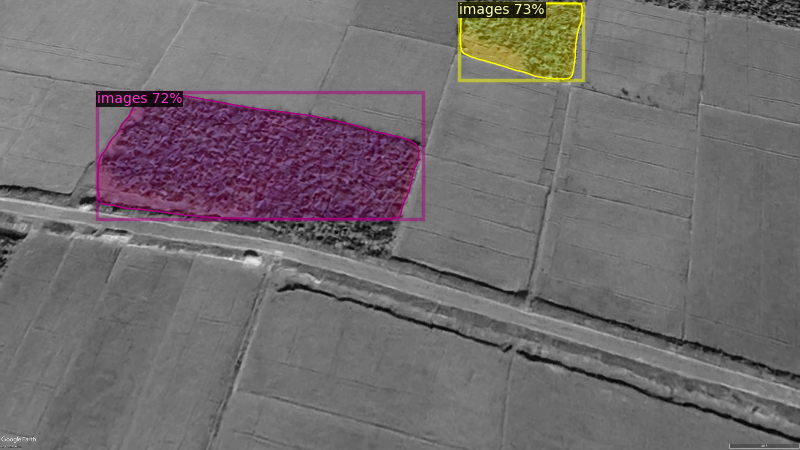

Total number of pixels of sugarcane fields: 8034825
3.174132604008177 km2
3.174132604008177 km2
Production : [[607491.30060358]]


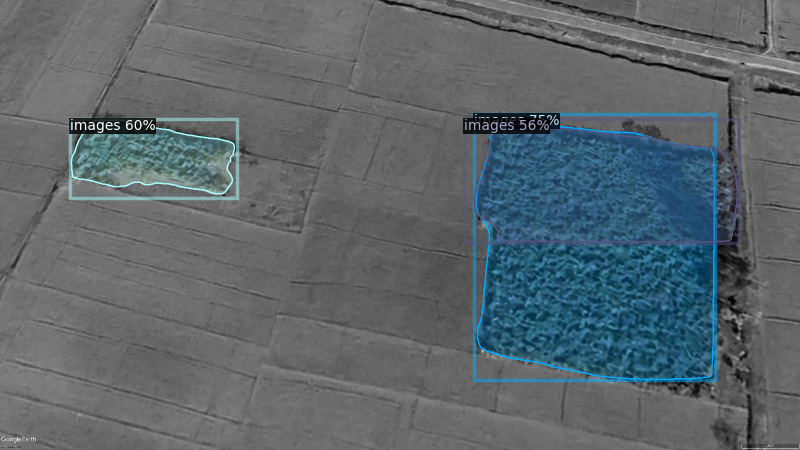

Total number of pixels of sugarcane fields: 8002849
4.979398586678319 km2
4.979398586678319 km2
Production : [[607615.34746363]]


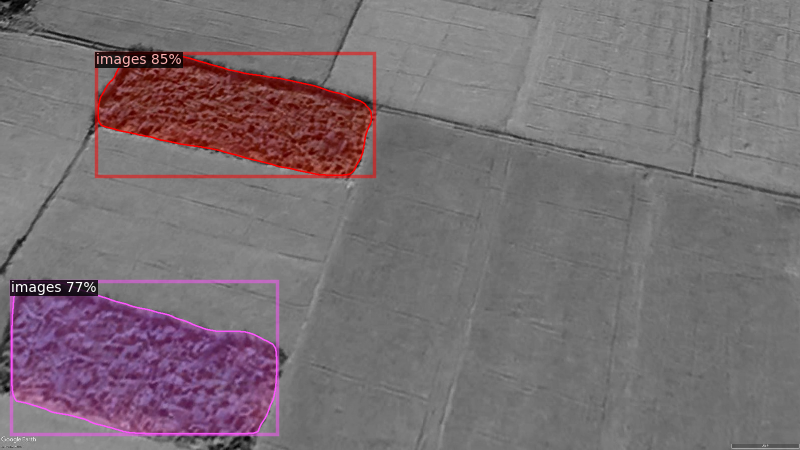

Total number of pixels of sugarcane fields: 8070601
3.901311181896606 km2
3.901311181896606 km2
Production : [[607541.26787718]]


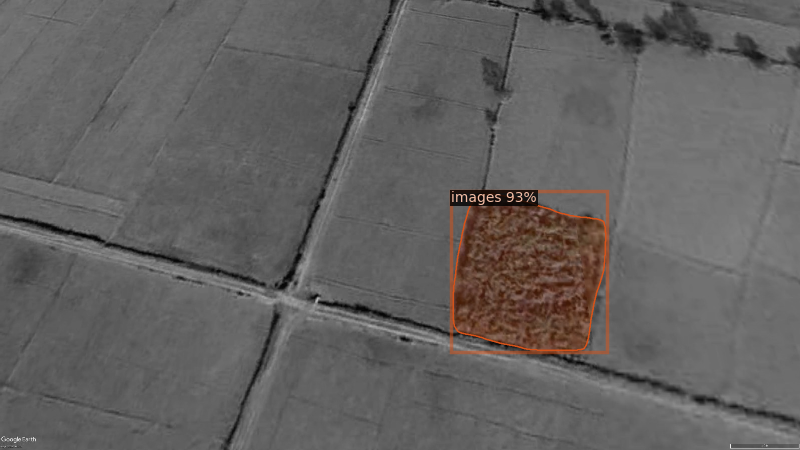

Total number of pixels of sugarcane fields: 7950857
1.4256240972933272 km2
1.4256240972933272 km2
Production : [[607371.15377087]]


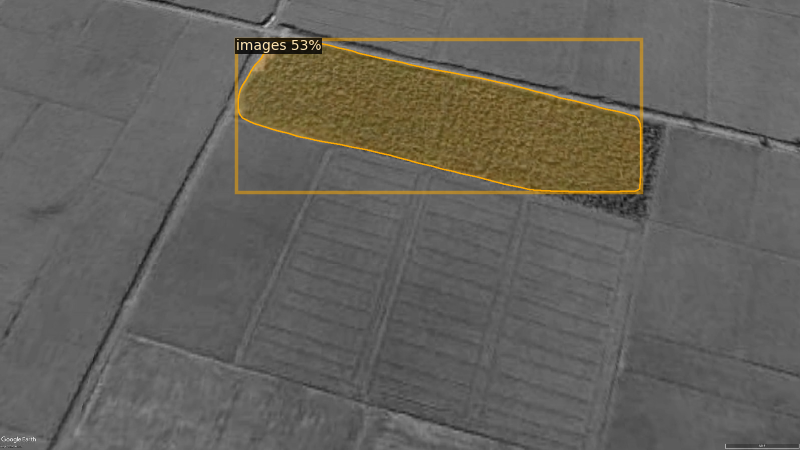

Total number of pixels of sugarcane fields: 7972854
3.9491411639954688 km2
3.9491411639954688 km2
Production : [[607544.55446163]]


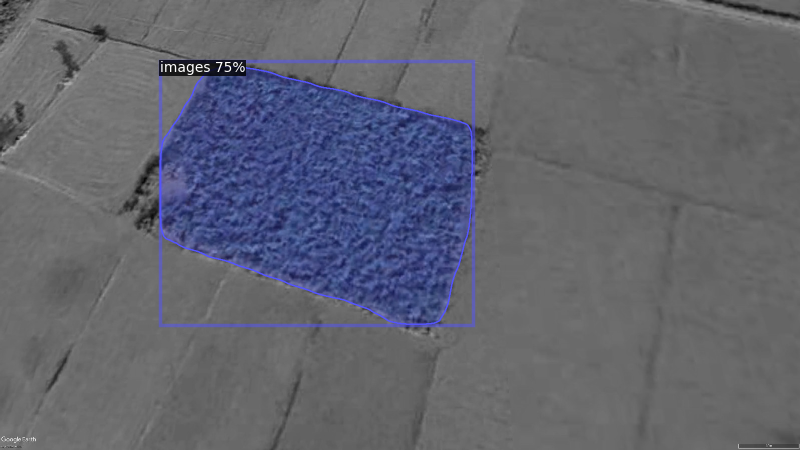

Total number of pixels of sugarcane fields: 7996665
0.7973198827261114 km2
0.7973198827261114 km2
Production : [[607327.98054005]]


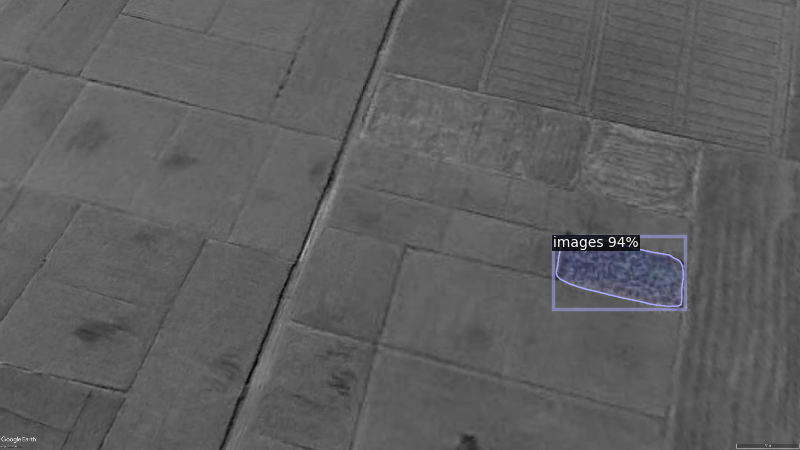

Total number of pixels of sugarcane fields: 7937084
1.255164207661151 km2
1.255164207661151 km2
Production : [[607359.44080764]]


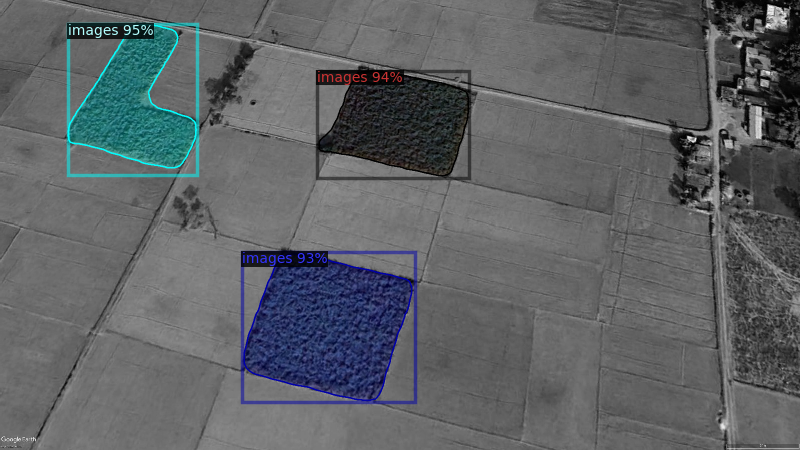

Total number of pixels of sugarcane fields: 7982614
8.874703616300792 km2
8.874703616300792 km2
Production : [[607883.0090506]]


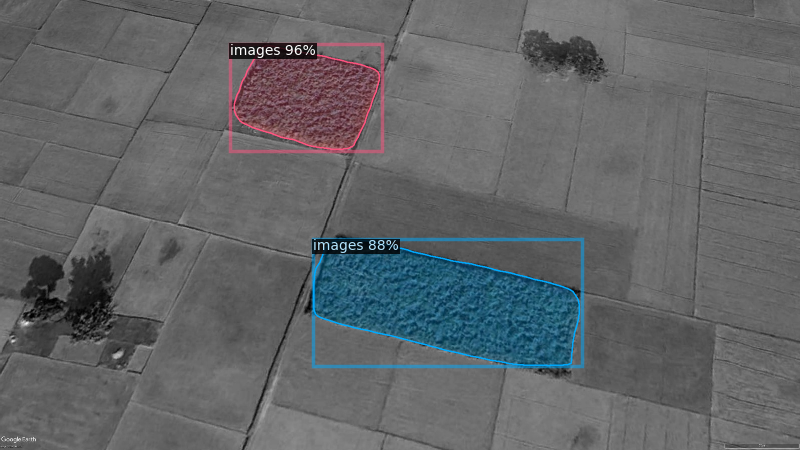

Total number of pixels of sugarcane fields: 7977966
6.523989105156142 km2
6.523989105156142 km2
Production : [[607721.48229678]]


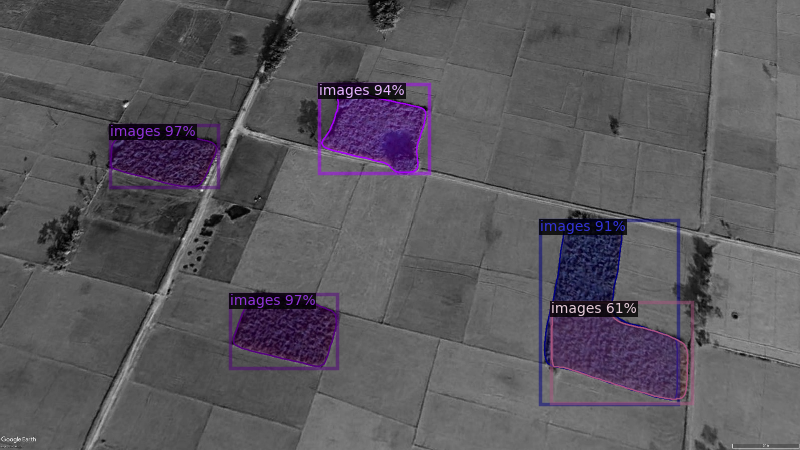

Total number of pixels of sugarcane fields: 7978908
12.785508994463903 km2
12.785508994463903 km2
Production : [[608151.73572693]]


In [ ]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import linear_model
from sklearn.model_selection import train_test_split


from detectron2.utils.visualizer import ColorMode
zoom_array=[10,8,9,15,9,20,16,6,7,5]
def areaPerPixel(zoom, tiles,area):

    totalTiles=(2*zoom) * (2*zoom)
    areaPerTile=earthArea/totalTiles

    landArea = areaPerTile*tiles
    resolution = area
    AreaPerPixel = landArea/resolution
    print(AreaPerPixel, "km2")
    return AreaPerPixel


df = pd.read_csv("drive/MyDrive/colab/sugarcane_data.csv")
print(df)

x_df = df[['Area']]
y_df = df[['Production']]

x_train, x_test, y_train, y_test = train_test_split(x_df, y_df, test_size=0.2)

reg = linear_model.LinearRegression()
reg.fit(x_train.values,y_train)

plt.xlabel('Area')
plt.ylabel('Production')
plt.scatter(x_df,y_df,marker="+",color='red')
plt.plot(x_df,reg.predict(x_df.values),color='blue')
plt.show()

print(reg.score(x_test.values,y_test))

for i in range(1,11):
  im = cv2.imread("drive/MyDrive/colab/sugarcane_pics/" + str(i) + ".jpeg")
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=balloon_metadata,
                scale=0.5,
                instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
  )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

  image = out.get_image()[:, :, ::-1]
  hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  lower_color = np.array([0, 0, 0])
  upper_color = np.array([128 , 128 , 128])
  color_mask = cv2.inRange(hsv_image, lower_color, upper_color)
  pixel_count_color = np.count_nonzero(color_mask)
  height, width, channels = image.shape

  total_pixels = 3840 * 2160

  print(f"Total number of pixels of sugarcane fields: {total_pixels - pixel_count_color}")
  earthArea = 510072000


  areaPerPixel(zoom_array[i-1],20,total_pixels - pixel_count_color)
  print("Production : " + str(reg.predict([[areaPerPixel(zoom_array[i-1],20,total_pixels - pixel_count_color)]])))